# More experiments

**General idea:** Expand on `02-initial-experiments.ipynb` with further experiments on the `rls-species-100-min-images-4` dataset, with the goals of gaining a deeper understanding of the models and library while improving performance on the dataset.

## Conclusions

* Taking a bigger crop significantly improves results
* Tinkering with the augmentation further improves things
* It's still hard to get MixUp and label smoothing to yield improvements
* When also looking at https://www.kaggle.com/yanirseroussi/deep-fish-initial-experiments/notebook (including its versions), the effect of a larger batch size is inconsistent, and using a deeper model doesn't help (at least with my current settings)
* It seems likely that there are gains to be had from the following data-level and pipeline tweaks:
  * Switch to a stratified split (e.g., _Halichoeres hortulanus_ only has one training example)
  * Clean up the dataset(s) by adding manual exclusions without regeneration (can be on the experiment level by overriding `get_items()` &ndash; add dict mapping each excluded filename to the reason it was excluded)
  * Experiment with adding fish detection to the pipeline (can be done as segmentation + replacement of background with noise)
  
  As these changes would make the results incomparable to the current set of experiments, they should be made in a new notebook with a separate MLflow experiment.

### Boilerplate and reproduction of previous results

In [56]:
import functools
import gc

from fastai.vision.all import *
import mlflow

from ichthywhat import experiments

%config InlineBackend.figure_format = 'retina'

In [2]:
mlflow.set_tracking_uri("sqlite:////home/yanir/projects/deep-fish/mlruns.db")
mlflow.set_registry_uri("file:///home/yanir/projects/deep-fish/mlruns")
mlflow.set_experiment("rls-species-100-min-images-4")

In [3]:
gc.collect()
torch.cuda.empty_cache()

In [4]:
create_reproducible_learner = functools.partial(
    experiments.create_reproducible_learner,
    dataset_path=Path(
        "/home/yanir/projects/deep-fish/data/rls-species-100-min-images-4"
    ),
)

Found 539 items
2 datasets of sizes 432,107
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_species_from_path -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (224, 224), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.2, 'p': 1.0, 'draw': None, 'batch': False}


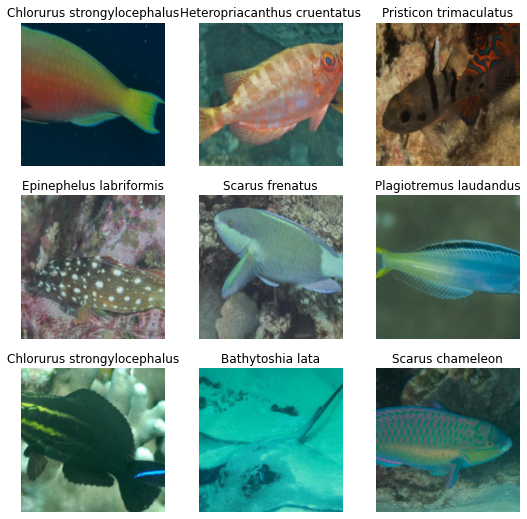

In [6]:
create_reproducible_learner(resnet18, dls_kwargs=dict(verbose=True)).dls.show_batch()

In [6]:
with mlflow.start_run(run_name="initial"):
    learner = create_reproducible_learner(resnet18)

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(224, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms()")

    learner.fine_tune(20)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.253374,5.668382,0.037383,0.046729,0.130841,00:06


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,5.589038,5.008295,0.037383,0.084112,0.177570,00:06
1,5.386600,4.706632,0.056075,0.102804,0.261682,00:06
2,5.155347,4.411570,0.093458,0.177570,0.327103,00:05
3,4.778166,4.053188,0.140187,0.242991,0.411215,00:06
4,4.442001,3.672914,0.205607,0.317757,0.495327,00:05
5,4.032203,3.353746,0.252336,0.373832,0.616822,00:05
6,3.641403,3.101541,0.261682,0.439252,0.663551,00:06
7,3.257939,2.903774,0.280374,0.495327,0.710280,00:06
8,2.922054,2.730302,0.364486,0.495327,0.738318,00:06
9,2.598321,2.617196,0.345794,0.523364,0.775701,00:06


### Crop size & scale experiments

* Smaller batch size is required to avoid running out of memory (local GPU is only 4GB)
* Larger batch sizes are on https://www.kaggle.com/yanirseroussi/deep-fish-initial-experiments (need to look through older versions for outputs) &ndash; the results are inconsistent
* The larger crop size yields much better results, which generalise to the larger dataset (see `02b-initial-experiments-larger-datasets.ipynb`)
* Longer training seems worthwhile &ndash; settled on 10 frozen & 200 unfrozen due to Kaggle experiments (see versions 5 & 6)
* `min_scale=0.5` appears to be good enough and doesn't require tinkering

In [7]:
with mlflow.start_run(run_name="crop-448-min-scale-0.5"):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(item_tfms=RandomResizedCrop(448, min_scale=0.5)),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms()")
    mlflow.log_param("bs", 16)

    learner.fine_tune(20)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.142416,4.194685,0.130841,0.177570,0.373832,00:15


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.575489,3.977017,0.177570,0.224299,0.420561,00:18
1,4.223039,3.751629,0.205607,0.271028,0.457944,00:19
2,3.755757,3.368311,0.233645,0.345794,0.560748,00:20
3,3.211327,2.990422,0.224299,0.448598,0.700935,00:20
4,2.615231,2.777588,0.317757,0.514019,0.738318,00:19
5,2.147833,2.524185,0.383178,0.570093,0.775701,00:22
6,1.730026,2.232526,0.467290,0.616822,0.822430,00:22
7,1.322231,2.181488,0.495327,0.579439,0.831776,00:22
8,1.010265,1.968513,0.560748,0.710280,0.841121,00:22
9,0.768933,1.916387,0.570093,0.691589,0.850467,00:22


In [9]:
with mlflow.start_run(run_name="crop-448-min-scale-0.5-longer-training"):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(item_tfms=RandomResizedCrop(448, min_scale=0.5)),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms()")
    mlflow.log_param("bs", 16)

    learner.fine_tune(200, freeze_epochs=10)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.420015,5.012721,0.009346,0.046729,0.130841,00:15
1,6.186358,4.759651,0.018692,0.056075,0.168224,00:15
2,5.829740,4.422307,0.065421,0.158879,0.299065,00:15
3,5.262142,3.911920,0.130841,0.261682,0.467290,00:15
4,4.494858,3.522235,0.196262,0.336449,0.598131,00:16
5,3.728633,3.176498,0.271028,0.392523,0.654206,00:16
6,3.045155,2.943713,0.355140,0.504673,0.700935,00:16
7,2.511082,2.664684,0.364486,0.542056,0.766355,00:18
8,2.011069,2.615022,0.364486,0.588785,0.766355,00:18
9,1.588130,2.524089,0.411215,0.598131,0.775701,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,0.746307,2.424466,0.392523,0.626168,0.813084,00:22
1,0.692743,2.369525,0.429907,0.607477,0.794393,00:22
2,0.618870,2.285934,0.429907,0.626168,0.822430,00:22
3,0.549507,2.238251,0.457944,0.598131,0.841121,00:22
4,0.519031,2.167851,0.476636,0.644860,0.831776,00:22
5,0.455096,2.087985,0.485981,0.635514,0.841121,00:22
6,0.423964,2.017416,0.495327,0.654206,0.869159,00:22
7,0.389814,2.014328,0.495327,0.626168,0.841121,00:22
8,0.345525,2.037260,0.495327,0.663551,0.850467,00:22
9,0.322885,1.971887,0.504673,0.663551,0.841121,00:22


In [8]:
with mlflow.start_run(run_name="crop-448-min-scale-0.1"):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(item_tfms=RandomResizedCrop(448, min_scale=0.1)),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.1)")
    mlflow.log_param("batch_tfms", "aug_transforms()")
    mlflow.log_param("bs", 16)

    learner.fine_tune(20)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.178741,4.379553,0.074766,0.140187,0.327103,00:14


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.809143,4.160265,0.084112,0.205607,0.411215,00:18
1,4.655496,3.968115,0.140187,0.261682,0.457944,00:18
2,4.325202,3.696304,0.177570,0.317757,0.542056,00:19
3,3.806383,3.342895,0.261682,0.383178,0.579439,00:20
4,3.368855,3.144383,0.252336,0.429907,0.691589,00:19
5,2.971521,3.021685,0.261682,0.504673,0.710280,00:19
6,2.601604,2.603154,0.373832,0.579439,0.766355,00:21
7,2.237659,2.549191,0.355140,0.560748,0.785047,00:22
8,1.923731,2.501769,0.392523,0.598131,0.850467,00:22
9,1.623779,2.431151,0.373832,0.616822,0.841121,00:22


In [5]:
for min_scale, max_scale in [(0.1, 0.9), (0.25, 0.75), (0.25, 1.0), (0.75, 1.25)]:
    print(min_scale, max_scale)
    with mlflow.start_run(
        run_name=f"crop-448-min-scale-{min_scale}-max-scale-{max_scale}"
    ):
        learner = create_reproducible_learner(
            resnet18,
            db_kwargs=dict(
                item_tfms=RandomResizedCrop(
                    448, min_scale=min_scale, max_scale=max_scale
                )
            ),
            dls_kwargs=dict(bs=16),
        )

        mlflow.log_param("model", learner.arch.__name__)
        mlflow.log_param(
            "item_tfms",
            f"RandomResizedCrop(448, min_scale={min_scale}, max_scale={max_scale})",
        )
        mlflow.log_param("batch_tfms", "aug_transforms()")
        mlflow.log_param("bs", 16)

        learner.fine_tune(20)

        mlflow.log_metrics(
            experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
        )

0.1 0.9


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.088858,4.417362,0.093458,0.177570,0.327103,00:15


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.940070,4.221671,0.102804,0.186916,0.383178,00:18
1,4.694302,4.042192,0.149533,0.261682,0.457944,00:18
2,4.350965,3.763718,0.186916,0.317757,0.467290,00:19
3,3.920304,3.439205,0.252336,0.383178,0.570093,00:19
4,3.449876,3.205992,0.233645,0.392523,0.644860,00:19
5,2.989604,3.036323,0.242991,0.467290,0.691589,00:19
6,2.623815,2.749802,0.327103,0.495327,0.728972,00:20
7,2.239436,2.615330,0.420561,0.542056,0.775701,00:22
8,1.926870,2.523600,0.383178,0.598131,0.803738,00:22
9,1.624135,2.426776,0.392523,0.635514,0.841121,00:22


0.25 0.75


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.133531,4.210138,0.121495,0.214953,0.383178,00:17


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.556025,3.989578,0.130841,0.261682,0.457944,00:22
1,4.355368,3.761051,0.177570,0.317757,0.467290,00:22
2,4.016353,3.547568,0.214953,0.355140,0.532710,00:22
3,3.557528,3.214756,0.271028,0.401869,0.607477,00:22
4,3.020384,3.066940,0.242991,0.467290,0.719626,00:22
5,2.570386,2.754880,0.355140,0.551402,0.794393,00:22
6,2.163134,2.428416,0.448598,0.616822,0.785047,00:22
7,1.759021,2.335030,0.439252,0.626168,0.803738,00:22
8,1.436245,2.100502,0.504673,0.672897,0.850467,00:22
9,1.143030,2.128745,0.504673,0.672897,0.831776,00:22


0.25 1.0


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.176204,4.317272,0.084112,0.149533,0.345794,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.707275,4.142539,0.093458,0.196262,0.383178,00:22
1,4.371889,3.895689,0.140187,0.252336,0.467290,00:22
2,4.021389,3.593458,0.177570,0.327103,0.514019,00:22
3,3.546783,3.215633,0.233645,0.411215,0.635514,00:22
4,3.058433,2.988882,0.224299,0.448598,0.691589,00:22
5,2.587446,2.670940,0.355140,0.551402,0.747664,00:22
6,2.151284,2.459254,0.439252,0.616822,0.794393,00:22
7,1.774138,2.348174,0.411215,0.607477,0.850467,00:22
8,1.486683,2.236352,0.439252,0.607477,0.878505,00:22
9,1.187164,2.092669,0.476636,0.682243,0.841121,00:22


0.75 1.25


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.087059,4.147157,0.130841,0.214953,0.364486,00:17


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.289791,3.901849,0.168224,0.242991,0.429907,00:22
1,3.927382,3.607932,0.205607,0.336449,0.495327,00:22
2,3.362605,3.249385,0.271028,0.429907,0.616822,00:22
3,2.804866,2.854052,0.327103,0.523364,0.719626,00:22
4,2.238099,2.630426,0.401869,0.588785,0.738318,00:22
5,1.749405,2.261272,0.514019,0.663551,0.785047,00:22
6,1.342248,2.115481,0.514019,0.672897,0.822430,00:22
7,0.980307,2.023376,0.495327,0.700935,0.831776,00:22
8,0.735395,1.981950,0.551402,0.663551,0.859813,00:22
9,0.547528,1.892540,0.523364,0.691589,0.878505,00:22


In [6]:
for min_scale, max_scale in [(0.4, 1.0), (0.6, 1.0), (0.8, 1.0)]:
    print(min_scale, max_scale)
    with mlflow.start_run(
        run_name=f"crop-448-min-scale-{min_scale}-max-scale-{max_scale}"
    ):
        learner = create_reproducible_learner(
            resnet18,
            db_kwargs=dict(
                item_tfms=RandomResizedCrop(
                    448, min_scale=min_scale, max_scale=max_scale
                )
            ),
            dls_kwargs=dict(bs=16),
        )

        mlflow.log_param("model", learner.arch.__name__)
        mlflow.log_param(
            "item_tfms",
            f"RandomResizedCrop(448, min_scale={min_scale}, max_scale={max_scale})",
        )
        mlflow.log_param("batch_tfms", "aug_transforms()")
        mlflow.log_param("bs", 16)

        learner.fine_tune(20)

        mlflow.log_metrics(
            experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
        )

0.4 1.0


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.166939,4.208828,0.084112,0.205607,0.383178,00:15


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.483140,4.029919,0.112150,0.186916,0.429907,00:18
1,4.263593,3.796789,0.158879,0.280374,0.495327,00:19
2,3.838670,3.497578,0.196262,0.411215,0.560748,00:20
3,3.311913,3.111965,0.242991,0.485981,0.644860,00:20
4,2.801621,2.847600,0.327103,0.551402,0.700935,00:19
5,2.343482,2.575156,0.401869,0.607477,0.794393,00:21
6,1.905887,2.228947,0.420561,0.635514,0.822430,00:22
7,1.523443,2.032597,0.485981,0.672897,0.869159,00:22
8,1.216584,2.109638,0.485981,0.663551,0.822430,00:22
9,0.944486,2.015023,0.467290,0.672897,0.841121,00:22


0.6 1.0


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.111106,4.184708,0.121495,0.186916,0.401869,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.421350,3.942455,0.149533,0.224299,0.467290,00:22
1,4.027701,3.651521,0.158879,0.327103,0.551402,00:22
2,3.547272,3.288673,0.224299,0.383178,0.635514,00:22
3,3.014224,2.884836,0.308411,0.514019,0.682243,00:22
4,2.455632,2.730962,0.383178,0.542056,0.738318,00:22
5,1.983354,2.449738,0.439252,0.598131,0.794393,00:22
6,1.572686,2.148487,0.485981,0.598131,0.831776,00:22
7,1.168577,2.004236,0.495327,0.682243,0.850467,00:22
8,0.903619,1.985418,0.523364,0.719626,0.831776,00:22
9,0.678857,1.945484,0.523364,0.728972,0.878505,00:22


0.8 1.0


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.085719,4.144747,0.130841,0.186916,0.373832,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,4.293607,3.895024,0.177570,0.233645,0.439252,00:22
1,3.924845,3.616455,0.205607,0.327103,0.504673,00:22
2,3.361822,3.275592,0.280374,0.401869,0.626168,00:22
3,2.807278,2.907513,0.308411,0.523364,0.700935,00:22
4,2.237770,2.672034,0.373832,0.579439,0.728972,00:22
5,1.746710,2.361778,0.467290,0.635514,0.775701,00:22
6,1.335380,2.159604,0.504673,0.644860,0.794393,00:22
7,0.978246,2.049572,0.523364,0.682243,0.822430,00:22
8,0.732163,2.012379,0.542056,0.672897,0.813084,00:22
9,0.559256,1.931513,0.542056,0.691589,0.850467,00:22


In [7]:
with mlflow.start_run(run_name="crop-448-min-scale-0.6-longer-training"):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(item_tfms=RandomResizedCrop(448, min_scale=0.6)),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.6)")
    mlflow.log_param("batch_tfms", "aug_transforms()")
    mlflow.log_param("bs", 16)

    learner.fine_tune(200, freeze_epochs=10)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.430712,5.039589,0.028037,0.046729,0.158879,00:15
1,6.133425,4.783545,0.018692,0.065421,0.177570,00:15
2,5.720954,4.397380,0.074766,0.140187,0.308411,00:15
3,5.146711,3.826551,0.158879,0.252336,0.476636,00:15
4,4.408188,3.365745,0.196262,0.411215,0.598131,00:15
5,3.582001,3.076012,0.271028,0.457944,0.654206,00:16
6,2.913138,2.821783,0.383178,0.523364,0.738318,00:16
7,2.347001,2.515946,0.411215,0.598131,0.766355,00:18
8,1.843449,2.444235,0.420561,0.607477,0.757009,00:18
9,1.436389,2.320996,0.420561,0.626168,0.775701,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,0.614260,2.243423,0.439252,0.644860,0.785047,00:22
1,0.584502,2.184845,0.485981,0.635514,0.794393,00:22
2,0.503991,2.112724,0.504673,0.644860,0.822430,00:22
3,0.456509,2.041989,0.495327,0.644860,0.822430,00:22
4,0.416852,2.036186,0.504673,0.682243,0.813084,00:22
5,0.380091,1.968501,0.485981,0.691589,0.813084,00:22
6,0.347569,1.949564,0.532710,0.710280,0.841121,00:22
7,0.327336,1.899016,0.542056,0.691589,0.841121,00:22
8,0.291661,1.925560,0.532710,0.728972,0.831776,00:22
9,0.256020,1.886653,0.523364,0.747664,0.831776,00:22


### Augmentation experiments

* `mult=2.0` increases the intensity of several augmentations (see https://docs.fast.ai/vision.augment.html and the bottom of the notebook) in a way that improves performance
* Unsurprisingly, flipping vertically and setting `mult=4.0` take the augmentations too far from the validation set
* Rudimentary label smoothing and mixup still fail to yield exciting results, as in the previous round
* Random erasing isn't helpful in reducing overfitting

In [20]:
with mlflow.start_run(run_name="crop-448-min-scale-0.5-longer-training-aug-mult-2.0"):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(
            item_tfms=RandomResizedCrop(448, min_scale=0.5),
            batch_tfms=aug_transforms(mult=2.0),
        ),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms(mult=2.0)")
    mlflow.log_param("bs", 16)

    learner.fine_tune(200, freeze_epochs=10)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.388171,5.009414,0.000000,0.046729,0.140187,00:16
1,6.137424,4.810199,0.000000,0.056075,0.186916,00:15
2,5.884395,4.487383,0.028037,0.102804,0.289720,00:16
3,5.365725,4.030392,0.102804,0.261682,0.439252,00:16
4,4.768430,3.582028,0.140187,0.336449,0.551402,00:16
5,4.080695,3.251257,0.233645,0.364486,0.626168,00:16
6,3.467886,3.025225,0.289720,0.457944,0.663551,00:16
7,2.935680,2.774657,0.317757,0.542056,0.691589,00:17
8,2.458971,2.730453,0.336449,0.570093,0.738318,00:18
9,2.100730,2.504564,0.336449,0.616822,0.766355,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,1.198837,2.404176,0.401869,0.598131,0.794393,00:22
1,1.168131,2.271707,0.448598,0.644860,0.813084,00:22
2,1.058616,2.232598,0.439252,0.654206,0.831776,00:22
3,0.985790,2.198209,0.457944,0.654206,0.813084,00:22
4,0.911346,2.129121,0.457944,0.654206,0.841121,00:22
5,0.861638,2.049805,0.476636,0.672897,0.850467,00:22
6,0.808104,1.966099,0.495327,0.672897,0.859813,00:22
7,0.757611,1.933044,0.485981,0.682243,0.869159,00:22
8,0.677414,1.910780,0.514019,0.710280,0.878505,00:22
9,0.626696,1.837887,0.532710,0.710280,0.887850,00:22


In [21]:
with mlflow.start_run(
    run_name="crop-448-min-scale-0.5-longer-training-aug-mult-2.0-flip-vert"
):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(
            item_tfms=RandomResizedCrop(448, min_scale=0.5),
            batch_tfms=aug_transforms(mult=2.0, flip_vert=True),
        ),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms(mult=2.0, flip_vert=True)")
    mlflow.log_param("bs", 16)

    learner.fine_tune(200, freeze_epochs=10)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.272261,5.030817,0.000000,0.028037,0.121495,00:18
1,6.141114,4.813483,0.000000,0.037383,0.158879,00:18
2,5.863179,4.489224,0.037383,0.121495,0.271028,00:18
3,5.423337,4.079259,0.084112,0.224299,0.411215,00:18
4,4.878716,3.736053,0.149533,0.261682,0.467290,00:18
5,4.242316,3.321192,0.196262,0.411215,0.626168,00:18
6,3.701800,3.054721,0.233645,0.420561,0.728972,00:18
7,3.254773,2.908292,0.336449,0.495327,0.700935,00:18
8,2.799799,2.796804,0.345794,0.514019,0.728972,00:18
9,2.398160,2.618034,0.355140,0.523364,0.738318,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,1.604881,2.492940,0.373832,0.523364,0.803738,00:22
1,1.428765,2.420555,0.392523,0.532710,0.831776,00:22
2,1.409536,2.321139,0.411215,0.542056,0.841121,00:22
3,1.337912,2.271880,0.420561,0.579439,0.850467,00:22
4,1.217979,2.198279,0.439252,0.616822,0.813084,00:22
5,1.159681,2.138154,0.448598,0.635514,0.850467,00:22
6,1.095343,2.055505,0.495327,0.654206,0.850467,00:22
7,1.033320,2.020771,0.504673,0.663551,0.878505,00:22
8,0.981643,1.986152,0.514019,0.663551,0.878505,00:22
9,0.911255,1.919143,0.542056,0.691589,0.887850,00:23


In [22]:
with mlflow.start_run(run_name="crop-448-min-scale-0.5-longer-training-aug-mult-4.0"):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(
            item_tfms=RandomResizedCrop(448, min_scale=0.5),
            batch_tfms=aug_transforms(mult=4.0),
        ),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms(mult=4.0)")
    mlflow.log_param("bs", 16)

    learner.fine_tune(200, freeze_epochs=10)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.455136,5.091455,0.018692,0.056075,0.158879,00:18
1,6.301448,5.006168,0.028037,0.056075,0.130841,00:18
2,6.161780,4.730992,0.046729,0.065421,0.214953,00:18
3,5.917205,4.427046,0.065421,0.158879,0.289720,00:18
4,5.618563,4.093007,0.149533,0.214953,0.392523,00:18
5,5.147232,3.763318,0.205607,0.271028,0.457944,00:18
6,4.740516,3.536250,0.205607,0.355140,0.570093,00:18
7,4.347382,3.368340,0.252336,0.383178,0.588785,00:18
8,4.118662,3.265037,0.252336,0.373832,0.607477,00:18
9,3.858431,3.145252,0.289720,0.411215,0.626168,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,3.393940,2.981409,0.289720,0.411215,0.663551,00:22
1,3.329176,2.908518,0.299065,0.467290,0.672897,00:22
2,3.147034,2.858810,0.327103,0.476636,0.654206,00:22
3,3.054108,2.803986,0.327103,0.514019,0.700935,00:22
4,2.976212,2.741621,0.317757,0.532710,0.728972,00:22
5,2.922071,2.635437,0.327103,0.542056,0.719626,00:22
6,2.770445,2.553889,0.355140,0.551402,0.757009,00:22
7,2.672129,2.505076,0.327103,0.570093,0.766355,00:22
8,2.579167,2.464364,0.373832,0.560748,0.775701,00:22
9,2.510080,2.364769,0.364486,0.551402,0.747664,00:22


In [25]:
with mlflow.start_run(
    run_name="crop-448-min-scale-0.5-longer-training-aug-mult-2.0-mixup-label-smoothing"
):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(
            item_tfms=RandomResizedCrop(448, min_scale=0.5),
            batch_tfms=aug_transforms(mult=2.0),
        ),
        dls_kwargs=dict(bs=16),
        learner_kwargs=dict(
            loss_func=LabelSmoothingCrossEntropy(),
            cbs=[experiments.MLflowCallback(), MixUp()],
        ),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms(mult=2.0)")
    mlflow.log_param("bs", 16)
    mlflow.log_param("loss_func", "LabelSmoothingCrossEntropy()")
    mlflow.log_param("cbs", "MixUp()")

    learner.fine_tune(200, freeze_epochs=10)

    mlflow.log_metrics(
        experiments.get_learner_metrics_with_tta(learner, tta_prefix="tta_", beta=0)
    )

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.411503,5.074474,0.009346,0.046729,0.112150,00:15
1,6.213734,4.918558,0.009346,0.046729,0.140187,00:15
2,6.099303,4.675132,0.009346,0.056075,0.299065,00:15
3,5.769837,4.317687,0.112150,0.196262,0.373832,00:15
4,5.401807,3.997854,0.158879,0.271028,0.504673,00:16
5,4.932825,3.688116,0.158879,0.364486,0.588785,00:16
6,4.508248,3.417098,0.252336,0.401869,0.654206,00:16
7,4.196607,3.229552,0.308411,0.457944,0.757009,00:16
8,3.978491,3.226027,0.289720,0.504673,0.710280,00:16
9,3.799128,3.107537,0.308411,0.514019,0.738318,00:16


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,3.281200,2.996017,0.299065,0.542056,0.728972,00:22
1,3.158551,2.933580,0.327103,0.588785,0.757009,00:22
2,3.011330,2.872277,0.336449,0.588785,0.766355,00:22
3,2.970403,2.840030,0.345794,0.588785,0.775701,00:22
4,2.980819,2.794770,0.383178,0.644860,0.813084,00:22
5,2.924292,2.699506,0.439252,0.635514,0.803738,00:22
6,2.844682,2.660169,0.429907,0.626168,0.822430,00:22
7,2.751749,2.617665,0.448598,0.672897,0.831776,00:22
8,2.737251,2.632338,0.457944,0.663551,0.841121,00:22
9,2.706510,2.589376,0.485981,0.672897,0.813084,00:22


SuggestedLRs(minimum=1.58489319801447e-07, slide=0.00013182566908653826, steep=6.309573450380412e-07, valley=4.365158383734524e-05)

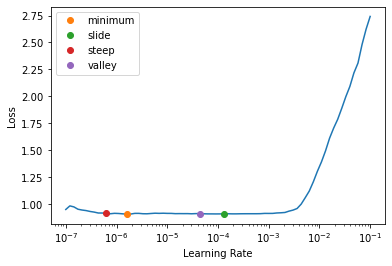

In [26]:
learner.remove_cb(MixUp)
learner.remove_cb(experiments.MLflowCallback)
learner.lr_find(
    suggest_funcs=[
        SuggestionMethod.Minimum,
        SuggestionMethod.Slide,
        SuggestionMethod.Steep,
        SuggestionMethod.Valley,
    ]
)

In [27]:
learner.add_cb(MixUp())
learner.fit(10, lr=0.00013182566908653826)

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,1.682919,2.141810,0.700935,0.822430,0.897196,00:18
1,1.687952,2.159638,0.682243,0.803738,0.906542,00:18
2,1.711863,2.214622,0.663551,0.775701,0.887850,00:19
3,1.715349,2.140010,0.663551,0.785047,0.906542,00:20
4,1.729582,2.066587,0.719626,0.850467,0.925234,00:20
5,1.731949,2.030155,0.719626,0.841121,0.934579,00:20
6,1.756218,2.003633,0.747664,0.859813,0.925234,00:20
7,1.777305,2.002160,0.738318,0.841121,0.906542,00:22
8,1.820103,2.114148,0.700935,0.850467,0.906542,00:22
9,1.774284,2.083794,0.700935,0.859813,0.915888,00:22


SuggestedLRs(minimum=8.317637839354575e-05, slide=0.00015848931798245758, steep=7.585775847473997e-07, valley=6.30957365501672e-05)

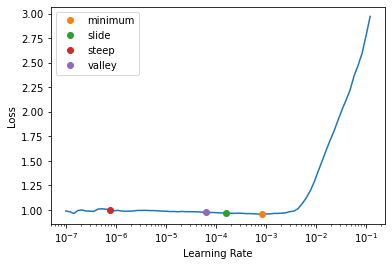

In [28]:
learner.remove_cb(MixUp)
learner.remove_cb(experiments.MLflowCallback)
learner.lr_find(
    suggest_funcs=[
        SuggestionMethod.Minimum,
        SuggestionMethod.Slide,
        SuggestionMethod.Steep,
        SuggestionMethod.Valley,
    ]
)

In [29]:
learner.add_cb(MixUp())
learner.fit(10, lr=0.00015848931798245758)

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,1.689930,2.176092,0.644860,0.813084,0.906542,00:18
1,1.723902,2.172714,0.672897,0.785047,0.887850,00:18
2,1.722228,2.071385,0.738318,0.822430,0.887850,00:19
3,1.718242,2.056418,0.738318,0.850467,0.897196,00:20
4,1.734806,2.120336,0.682243,0.822430,0.897196,00:22
5,1.717158,2.125282,0.682243,0.813084,0.906542,00:22
6,1.687443,2.103852,0.682243,0.813084,0.887850,00:22
7,1.729006,2.029933,0.738318,0.831776,0.925234,00:22
8,1.758403,2.058697,0.682243,0.841121,0.915888,00:22
9,1.773853,2.047276,0.672897,0.850467,0.887850,00:22


SuggestedLRs(minimum=1.58489319801447e-07, slide=0.0002290867705596611, steep=1.3182567499825382e-06, valley=0.0002754228771664202)

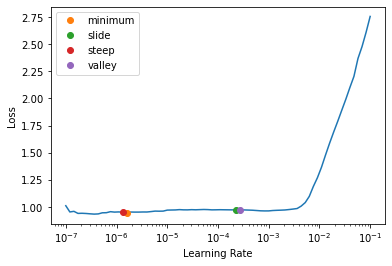

In [30]:
learner.remove_cb(MixUp)
learner.remove_cb(experiments.MLflowCallback)
learner.lr_find(
    suggest_funcs=[
        SuggestionMethod.Minimum,
        SuggestionMethod.Slide,
        SuggestionMethod.Steep,
        SuggestionMethod.Valley,
    ]
)

In [31]:
# Intentionally trying without re-adding MixUp, which represents the loss seen by the LR finder.
learner.fit(10, lr=0.0002290867705596611)

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,0.979672,2.070793,0.710280,0.841121,0.915888,00:18
1,0.966420,1.927268,0.757009,0.841121,0.925234,00:18
2,0.948862,1.995800,0.691589,0.831776,0.915888,00:19
3,0.943736,1.945255,0.719626,0.850467,0.915888,00:20
4,0.932814,1.891795,0.785047,0.850467,0.915888,00:19
5,0.930051,1.906380,0.766355,0.869159,0.925234,00:20
6,0.936835,1.974686,0.719626,0.822430,0.925234,00:22
7,0.936026,1.895975,0.766355,0.850467,0.915888,00:22
8,0.937491,1.973127,0.710280,0.841121,0.934579,00:22
9,0.949836,1.917133,0.710280,0.859813,0.925234,00:22


In [13]:
with mlflow.start_run(
    run_name="crop-448-min-scale-0.5-longer-training-aug-mult-2.0-random-erasing"
):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(
            item_tfms=RandomResizedCrop(448, min_scale=0.5),
            batch_tfms=aug_transforms(mult=2.0, xtra_tfms=RandomErasing),
        ),
        dls_kwargs=dict(bs=16),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(448, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms(mult=2.0, xtra_tfms=RandomErasing)")
    mlflow.log_param("bs", 16)

    learner.fine_tune(200, freeze_epochs=10)

    metrics = experiments.get_learner_metrics_with_tta(
        learner, tta_prefix="tta_", beta=0
    )
    mlflow.log_metrics(metrics)
metrics

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.378877,5.087071,0.009346,0.046729,0.112150,00:15
1,6.203169,4.977206,0.018692,0.037383,0.130841,00:15
2,5.927664,4.612773,0.018692,0.065421,0.233645,00:15
3,5.473917,4.218362,0.093458,0.186916,0.401869,00:16
4,4.908723,3.846062,0.149533,0.261682,0.504673,00:16
5,4.241515,3.449793,0.196262,0.392523,0.607477,00:16
6,3.746604,3.214815,0.224299,0.439252,0.654206,00:16
7,3.271979,3.038630,0.289720,0.485981,0.682243,00:16
8,2.880322,2.871674,0.355140,0.504673,0.710280,00:18
9,2.450723,2.695277,0.392523,0.514019,0.710280,00:18


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,1.593785,2.587121,0.373832,0.570093,0.728972,00:22
1,1.490621,2.452858,0.411215,0.542056,0.766355,00:22
2,1.425674,2.443378,0.429907,0.579439,0.775701,00:22
3,1.341421,2.330913,0.457944,0.588785,0.794393,00:22
4,1.343426,2.297004,0.420561,0.598131,0.794393,00:22
5,1.239515,2.221009,0.448598,0.607477,0.822430,00:22
6,1.205783,2.162121,0.429907,0.635514,0.822430,00:22
7,1.109279,2.096417,0.457944,0.607477,0.831776,00:22
8,1.024378,2.060591,0.476636,0.672897,0.831776,00:22
9,0.975786,2.026157,0.467290,0.682243,0.850467,00:22


{'train_loss': 0.01487444993108511,
 'valid_loss': 1.3296277523040771,
 'accuracy': 0.663551390171051,
 'top_3_accuracy': 0.7943925261497498,
 'top_10_accuracy': 0.9158878326416016,
 'tta_accuracy': 0.7196261882781982,
 'tta_top_3_accuracy': 0.84112149477005,
 'tta_top_10_accuracy': 0.9252336621284485}

## An even bigger crop

* Trimming the run name to set the baseline from the best settings so far
* An even small batch size is needed
* Even though the results are unimpressive, it's worth trying an uncropped version on Kaggle
* From looking at the misclassifications and the data, it seems like further improvements can be obtained from data manipulation (see top-level comment)

In [12]:
with mlflow.start_run(run_name="crop-640-baseline"):
    learner = create_reproducible_learner(
        resnet18,
        db_kwargs=dict(
            item_tfms=RandomResizedCrop(640, min_scale=0.5),
            batch_tfms=aug_transforms(mult=2.0),
        ),
        dls_kwargs=dict(bs=12),
    )

    mlflow.log_param("model", learner.arch.__name__)
    mlflow.log_param("item_tfms", "RandomResizedCrop(640, min_scale=0.5)")
    mlflow.log_param("batch_tfms", "aug_transforms(mult=2.0)")
    mlflow.log_param("bs", 12)

    learner.fine_tune(200, freeze_epochs=10)

    metrics = experiments.get_learner_metrics_with_tta(
        learner, tta_prefix="tta_", beta=0
    )
    mlflow.log_metrics(metrics)
metrics

epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.232860,4.913225,0.018692,0.037383,0.168224,00:25
1,6.025696,4.710773,0.009346,0.084112,0.242991,00:26
2,5.734609,4.389454,0.056075,0.112150,0.327103,00:27
3,5.248624,3.991919,0.112150,0.242991,0.429907,00:31
4,4.662094,3.594062,0.186916,0.336449,0.542056,00:31
5,4.076292,3.282917,0.252336,0.411215,0.598131,00:31
6,3.469738,3.176703,0.308411,0.429907,0.654206,00:31
7,3.003671,2.927073,0.383178,0.495327,0.738318,00:31
8,2.507264,2.826008,0.355140,0.532710,0.710280,00:31
9,2.196691,2.699362,0.345794,0.579439,0.785047,00:31


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,1.509067,2.505903,0.429907,0.607477,0.794393,00:39
1,1.358824,2.386045,0.439252,0.598131,0.803738,00:39
2,1.243423,2.327365,0.429907,0.626168,0.831776,00:39
3,1.097554,2.223016,0.476636,0.644860,0.841121,00:39
4,1.070636,2.135099,0.448598,0.654206,0.831776,00:39
5,0.996725,2.087473,0.448598,0.691589,0.850467,00:39
6,0.956967,2.032014,0.485981,0.672897,0.850467,00:39
7,0.917555,1.994558,0.485981,0.682243,0.859813,00:39
8,0.840481,1.979273,0.476636,0.691589,0.850467,00:39
9,0.789912,1.924440,0.485981,0.719626,0.869159,00:39


{'train_loss': 0.006273140665143728,
 'valid_loss': 1.2414840459823608,
 'accuracy': 0.7196261882781982,
 'top_3_accuracy': 0.84112149477005,
 'top_10_accuracy': 0.9439252614974976,
 'tta_accuracy': 0.7102803587913513,
 'tta_top_3_accuracy': 0.8504672646522522,
 'tta_top_10_accuracy': 0.9252336621284485}

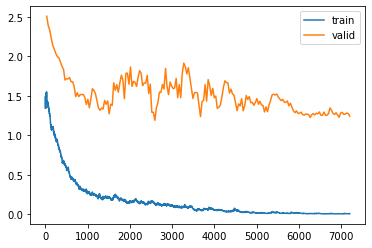

In [13]:
learner.recorder.plot_loss()

In [16]:
interp = ClassificationInterpretation.from_learner(learner)

In [20]:
interp.print_classification_report()

                              precision    recall  f1-score   support

          Achoerodus viridis       0.00      0.00      0.00         0
Amblyglyphidodon leucogaster       1.00      1.00      1.00         1
              Arothron mappa       1.00      1.00      1.00         1
          Arothron stellatus       1.00      1.00      1.00         1
  Asterropteryx semipunctata       1.00      1.00      1.00         1
        Aulostomus chinensis       0.00      0.00      0.00         2
    Bathytoshia brevicaudata       0.50      1.00      0.67         1
            Bathytoshia lata       0.50      1.00      0.67         1
        Batrachomoeus dubius       1.00      0.50      0.67         2
           Bodianus frenchii       0.00      0.00      0.00         0
           Caesioperca rasor       1.00      1.00      1.00         3
            Caranx ignobilis       1.00      1.00      1.00         1
           Carcharias taurus       1.00      1.00      1.00         2
         Centrobery

/home/yanir/.conda/envs/deep-fish/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/yanir/.conda/envs/deep-fish/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/yanir/.conda/envs/deep-fish/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/

In [18]:
interp.most_confused()

[('Lethrinus atkinsoni', 'Monotaxis heterodon', 2),
 ('Aulostomus chinensis', 'Monotaxis heterodon', 1),
 ('Aulostomus chinensis', 'Sphoeroides annulatus', 1),
 ('Batrachomoeus dubius', 'Octopus cyanea', 1),
 ('Chlorurus sordidus', 'Scarus chameleon', 1),
 ('Clepticus parrae', 'Chrysiptera notialis', 1),
 ('Coris sandeyeri', 'Halichoeres hartzfeldii', 1),
 ('Coryphopterus dicrus', 'Monotaxis heterodon', 1),
 ('Coryphopterus dicrus', 'Saurida nebulosa', 1),
 ('Elacatinus genie', 'Coris sandeyeri', 1),
 ('Epinephelus polyphekadion', 'Heteropriacanthus cruentatus', 1),
 ('Gnathanodon speciosus', 'Pomatoschistus minutus', 1),
 ('Halichoeres hortulanus', 'Cephalopholis argus', 1),
 ('Halichoeres hortulanus', 'Halichoeres hartzfeldii', 1),
 ('Halichoeres hortulanus', 'Thalassoma bifasciatum', 1),
 ('Hemigymnus fasciatus', 'Epinephelus polyphekadion', 1),
 ('Hippocampus angustus', 'Filicampus tigris', 1),
 ('Leptoscarus vaigiensis', 'Heteropriacanthus cruentatus', 1),
 ('Lethrinus atkinsoni',

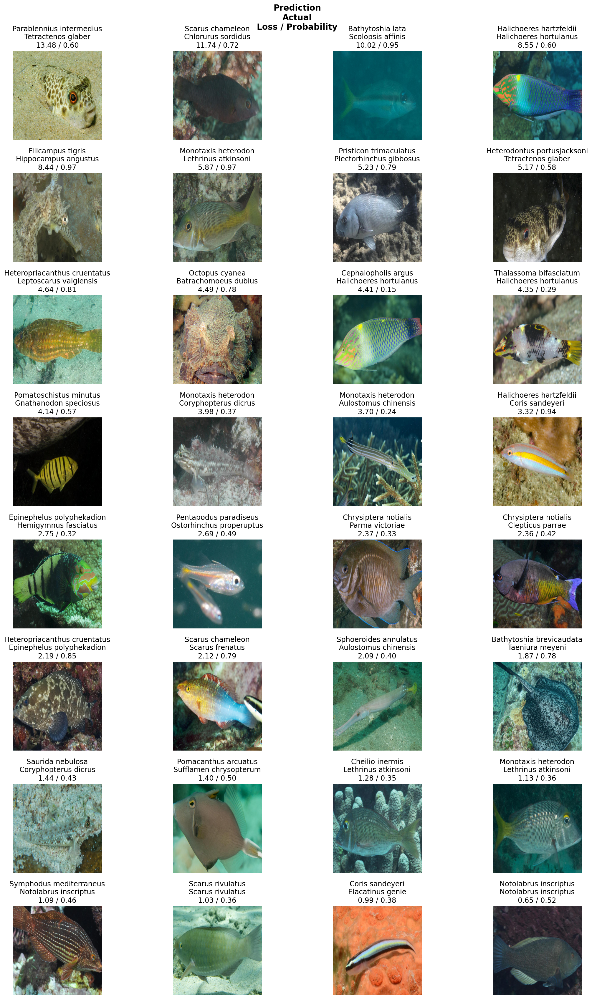

In [129]:
# Base version taken from https://github.com/fastai/fastai/blob/351f4b9314e2ea23684fb2e19235ee5c5ef8cbfd/fastai/interpret.py#L51
def fixed_plot_top_losses(self, k, largest=True, **kwargs):
    losses, idx = self.top_losses(k, largest)
    if not isinstance(self.inputs, tuple):
        self.inputs = (self.inputs,)
    if isinstance(self.inputs[0], Tensor):
        inps = tuple(o[idx] for o in self.inputs)
    else:
        inps = self.dl.create_batch(
            self.dl.before_batch([tuple(o[i] for o in self.inputs) for i in idx])
        )
    b = inps + tuple(
        o[idx] for o in (self.targs if is_listy(self.targs) else (self.targs,))
    )
    x, y, its = self.dl._pre_show_batch(b, max_n=k)
    b_out = inps + tuple(
        o[idx] for o in (self.decoded if is_listy(self.decoded) else (self.decoded,))
    )
    x1, y1, outs = self.dl._pre_show_batch(b_out, max_n=k)
    if its is not None:
        # plot_top_losses(x, y, its, outs.itemgot(slice(len(inps), None)), self.preds[idx], losses,  **kwargs)
        # Inlined from https://github.com/fastai/fastai/blob/6e44b354f4d12bdfa2c9530f38f851c54a05764d/fastai/vision/learner.py#L271
        # to edit the title
        samples = its
        outs = outs.itemgot(slice(len(inps), None))
        raws = self.preds[idx]
        nrows = kwargs.pop("nrows")
        ncols = kwargs.pop("ncols")
        figsize = kwargs.pop("figsize")
        axs = get_grid(
            len(samples),
            nrows=nrows,
            ncols=ncols,
            figsize=figsize,
            add_vert=1,
            title="Prediction\nActual\nLoss / Probability",
        )
        for ax, s, o, r, l in zip(axs, samples, outs, raws, losses):
            s[0].show(ctx=ax, **kwargs)
            ax.set_title(f"{o[0]}\n{s[1]}\n{l.item():.2f} / {r.max().item():.2f}")


fixed_plot_top_losses(interp, k=32, nrows=8, ncols=4, figsize=(16, 24))
plt.tight_layout()

## Playground

* Activation stats make things considerably slower, but may be worth exploring at a later stage
* Understanding what the augmentations do is crucial (see https://docs.fast.ai/vision.augment.html)

In [26]:
learner = create_reproducible_learner(
    resnet18, learner_kwargs=dict(cbs=ActivationStats(with_hist=True))
)
learner.fine_tune(20)

/home/yanir/.conda/envs/deep-fish/lib/python3.9/site-packages/fastai/callback/core.py:51: UserWarning: You are shadowing an attribute (modules) that exists in the learner. Use `self.learn.modules` to avoid this
  warn(f"You are shadowing an attribute ({name}) that exists in the learner. Use `self.learn.{name}` to avoid this")


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,6.253374,5.668382,0.037383,0.046729,0.130841,00:19


epoch,train_loss,valid_loss,accuracy,top_3_accuracy,top_10_accuracy,time
0,5.589038,5.008295,0.037383,0.084112,0.177570,00:21
1,5.386600,4.706632,0.056075,0.102804,0.261682,00:22
2,5.155347,4.411570,0.093458,0.177570,0.327103,00:22
3,4.778166,4.053188,0.140187,0.242991,0.411215,00:21
4,4.442001,3.672914,0.205607,0.317757,0.495327,00:21
5,4.032203,3.353746,0.252336,0.373832,0.616822,00:22
6,3.641403,3.101541,0.261682,0.439252,0.663551,00:22
7,3.257939,2.903774,0.280374,0.495327,0.710280,00:23
8,2.922054,2.730302,0.364486,0.495327,0.738318,00:23
9,2.598321,2.617196,0.345794,0.523364,0.775701,00:22


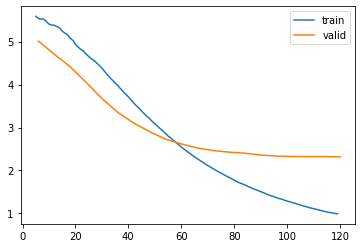

In [27]:
learner.recorder.plot_loss()

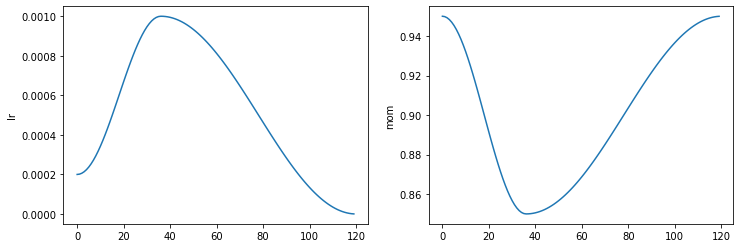

In [28]:
learner.recorder.plot_sched()

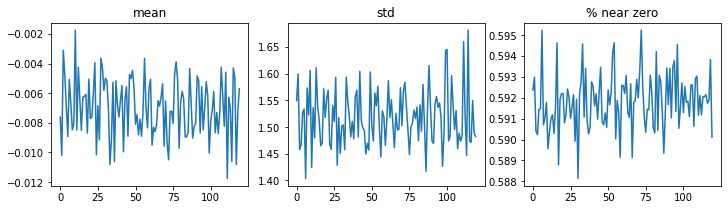

In [29]:
learner.activation_stats.plot_layer_stats(0)

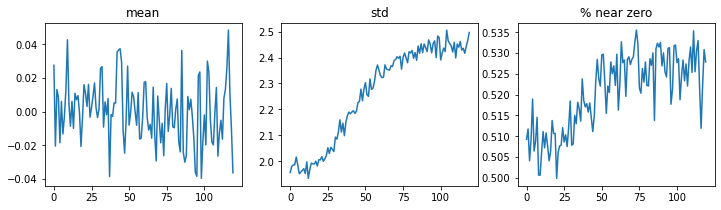

In [35]:
learner.activation_stats.plot_layer_stats(-1)

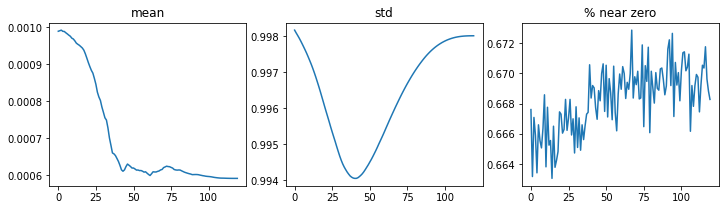

In [30]:
learner.activation_stats.plot_layer_stats(-2)

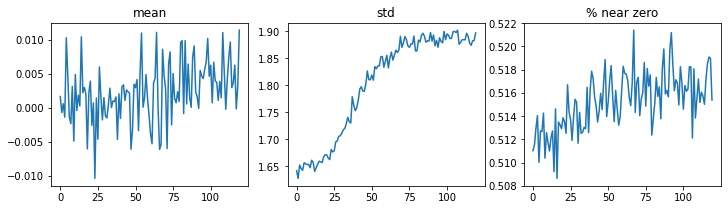

In [36]:
learner.activation_stats.plot_layer_stats(-3)

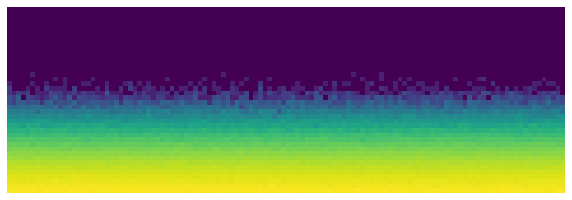

In [34]:
learner.activation_stats.color_dim(-2)

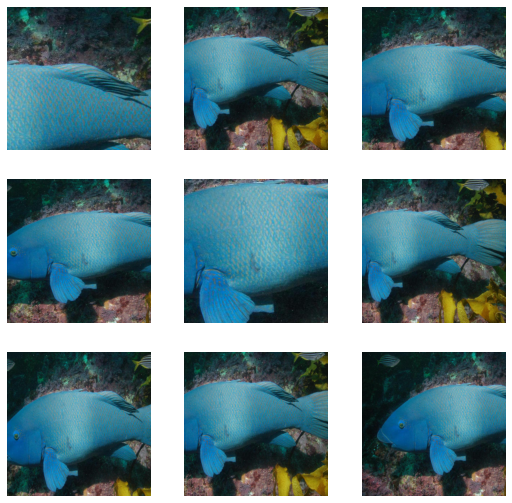

In [15]:
crop = RandomResizedCrop(448)
img = PILImage.create(
    "/home/yanir/projects/deep-fish/data/rls-species-100-min-images-4/achoerodus-viridis-0.jpg"
)
for ax in plt.subplots(3, 3, figsize=(9, 9))[1].flatten():
    show_image(crop(img), ctx=ax)

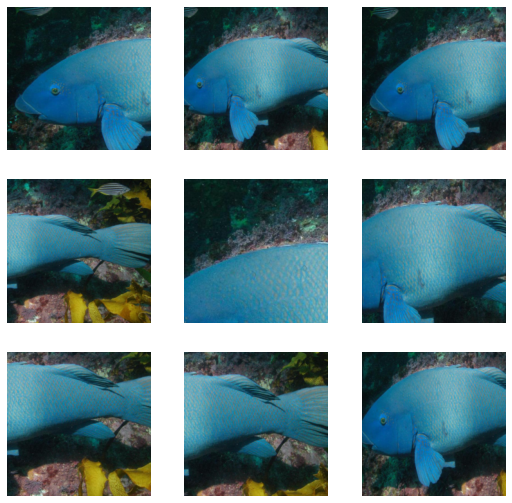

In [16]:
crop = RandomResizedCrop(224)
img = PILImage.create(
    "/home/yanir/projects/deep-fish/data/rls-species-100-min-images-4/achoerodus-viridis-0.jpg"
)
for ax in plt.subplots(3, 3, figsize=(9, 9))[1].flatten():
    show_image(crop(img), ctx=ax)

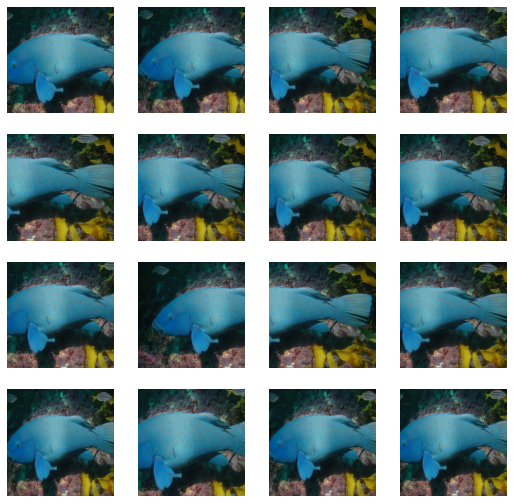

In [24]:
crop = RandomResizedCrop(448, min_scale=0.5)
img = PILImage.create(
    "/home/yanir/projects/deep-fish/data/rls-species-100-min-images-4/achoerodus-viridis-0.jpg"
)
for ax in plt.subplots(4, 4, figsize=(9, 9))[1].flatten():
    show_image(crop(img), ctx=ax)

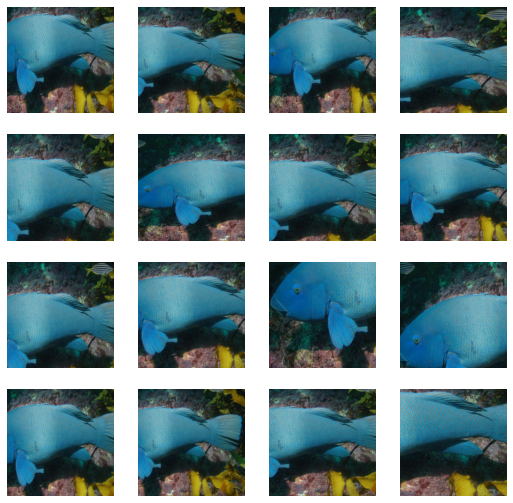

In [28]:
crop = RandomResizedCrop(448, min_scale=0.2, max_scale=0.8)
img = PILImage.create(
    "/home/yanir/projects/deep-fish/data/rls-species-100-min-images-4/achoerodus-viridis-0.jpg"
)
for ax in plt.subplots(4, 4, figsize=(9, 9))[1].flatten():
    show_image(crop(img), ctx=ax)

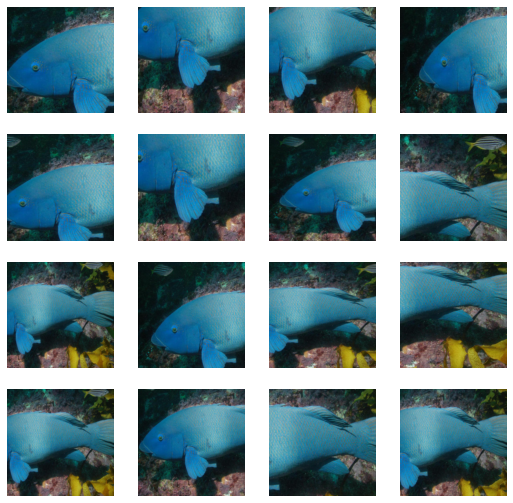

In [31]:
crop = RandomResizedCrop(224, min_scale=0.2, max_scale=0.8)
img = PILImage.create(
    "/home/yanir/projects/deep-fish/data/rls-species-100-min-images-4/achoerodus-viridis-0.jpg"
)
for ax in plt.subplots(4, 4, figsize=(9, 9))[1].flatten():
    show_image(crop(img), ctx=ax)

Found 539 items
2 datasets of sizes 432,107
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_species_from_path -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (448, 448), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.2, 'p': 1.0, 'draw': None, 'batch': False}


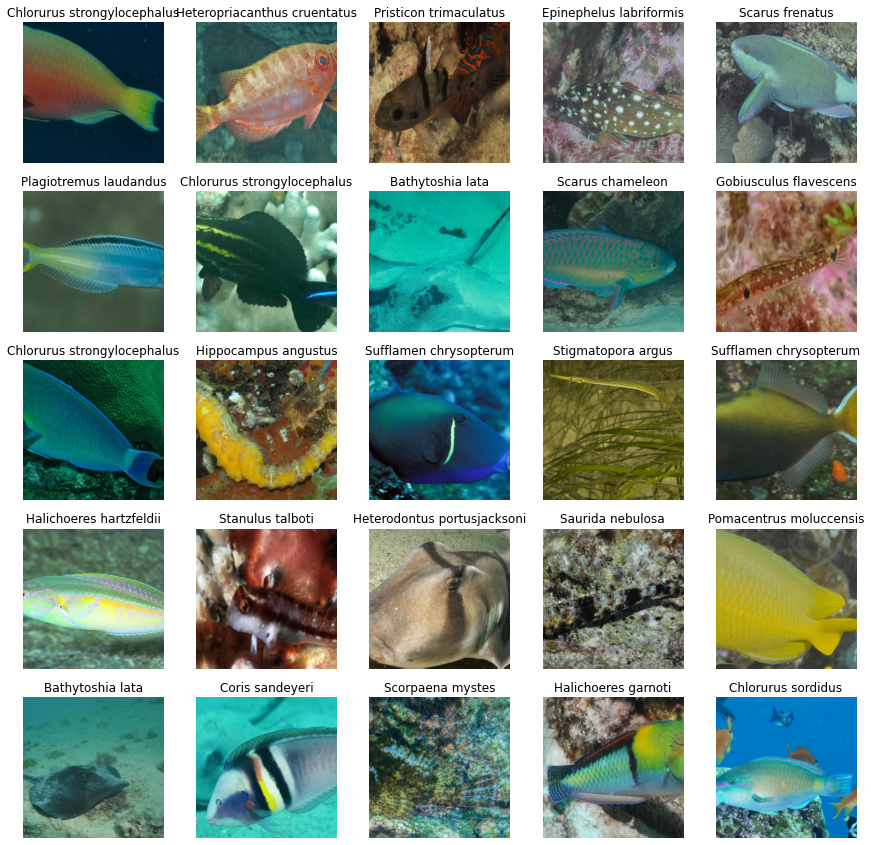

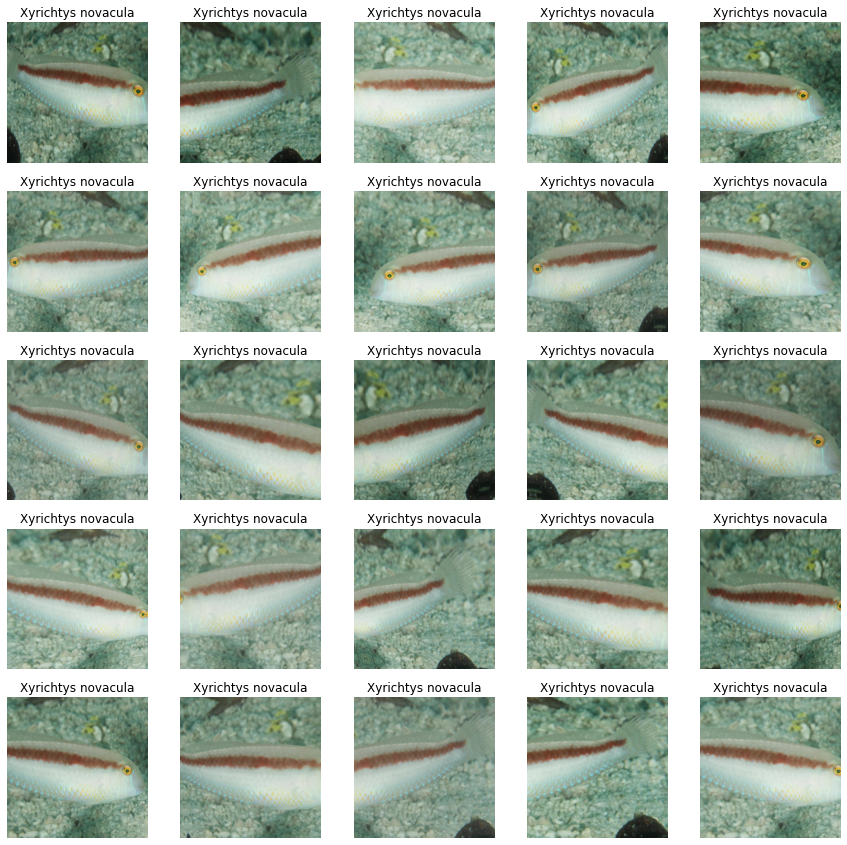

In [17]:
learner = create_reproducible_learner(
    resnet18,
    db_kwargs=dict(
        item_tfms=RandomResizedCrop(448, min_scale=0.5), batch_tfms=aug_transforms()
    ),
    dls_kwargs=dict(verbose=True),
    learner_kwargs=dict(cbs=None),
)
learner.dls.show_batch(max_n=25)
learner.dls.show_batch(max_n=25, unique=True)

Found 539 items
2 datasets of sizes 432,107
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_species_from_path -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (448, 448), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.4, 'p': 1.0, 'draw': None, 'batch': False}


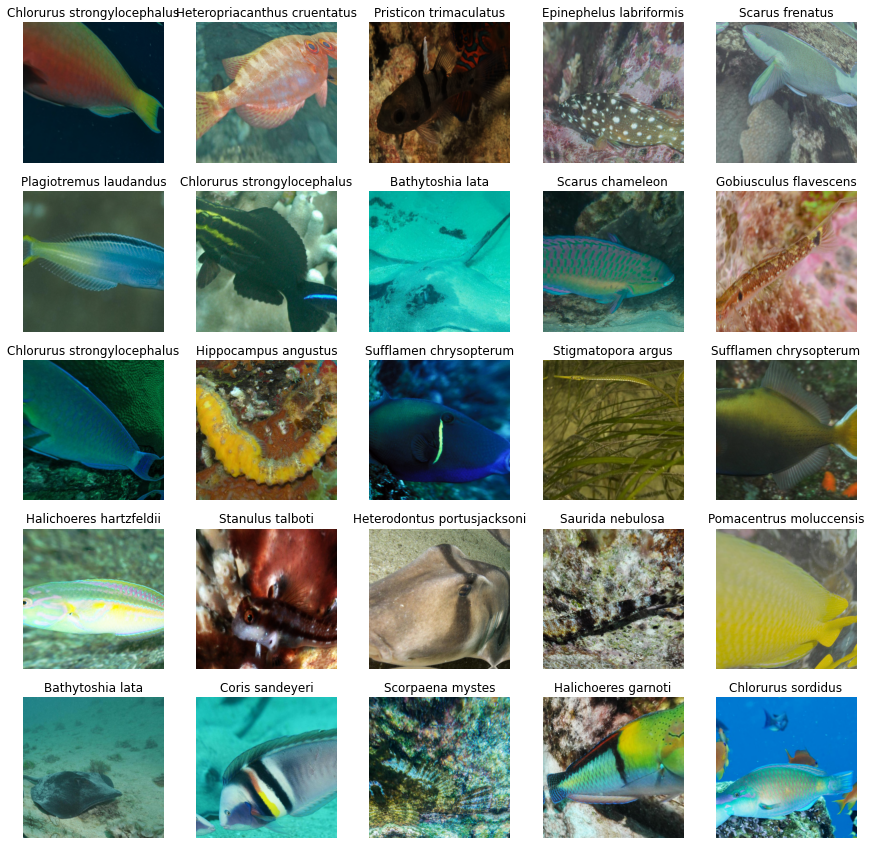

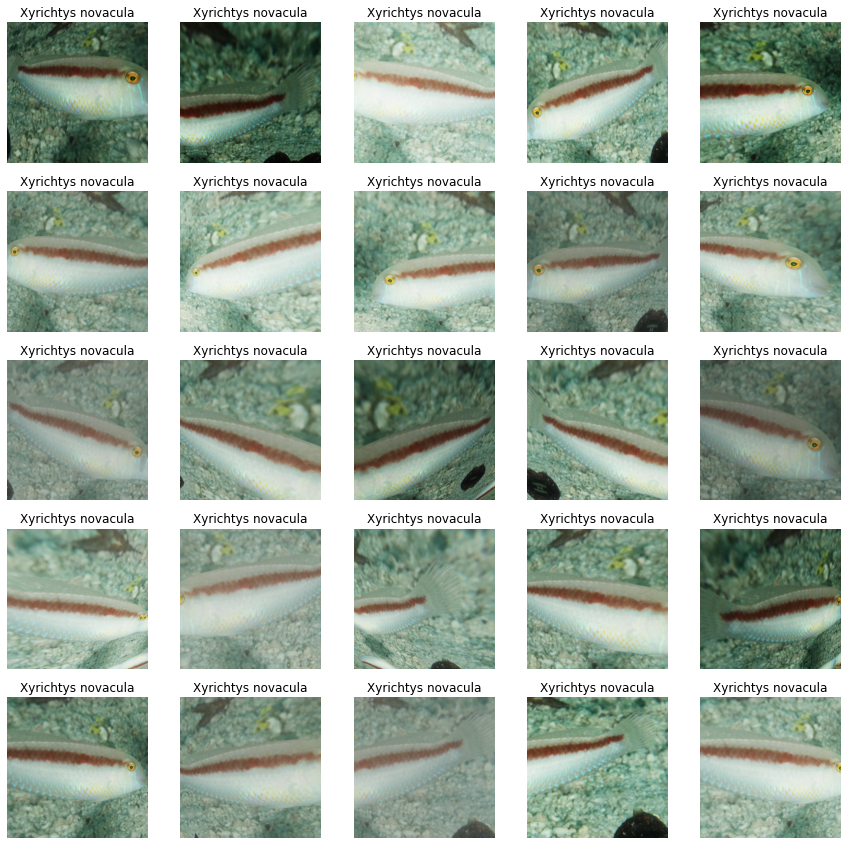

In [19]:
learner = create_reproducible_learner(
    resnet18,
    db_kwargs=dict(
        item_tfms=RandomResizedCrop(448, min_scale=0.5),
        batch_tfms=aug_transforms(mult=2.0, flip_vert=False),
    ),
    dls_kwargs=dict(verbose=True),
    learner_kwargs=dict(cbs=None),
)
learner.dls.show_batch(max_n=25)
learner.dls.show_batch(max_n=25, unique=True)

Found 539 items
2 datasets of sizes 432,107
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_species_from_path -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (448, 448), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Dihedral -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 1.0} -> Brightness -- {'max_lighting': 0.4, 'p': 1.0, 'draw': None, 'batch': False}


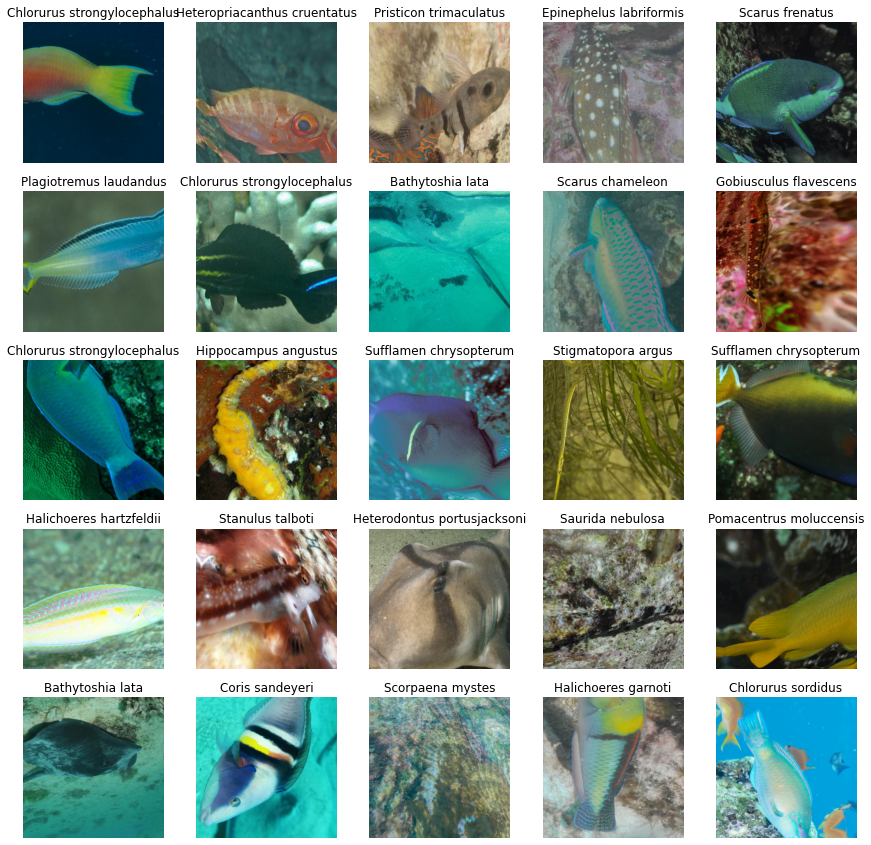

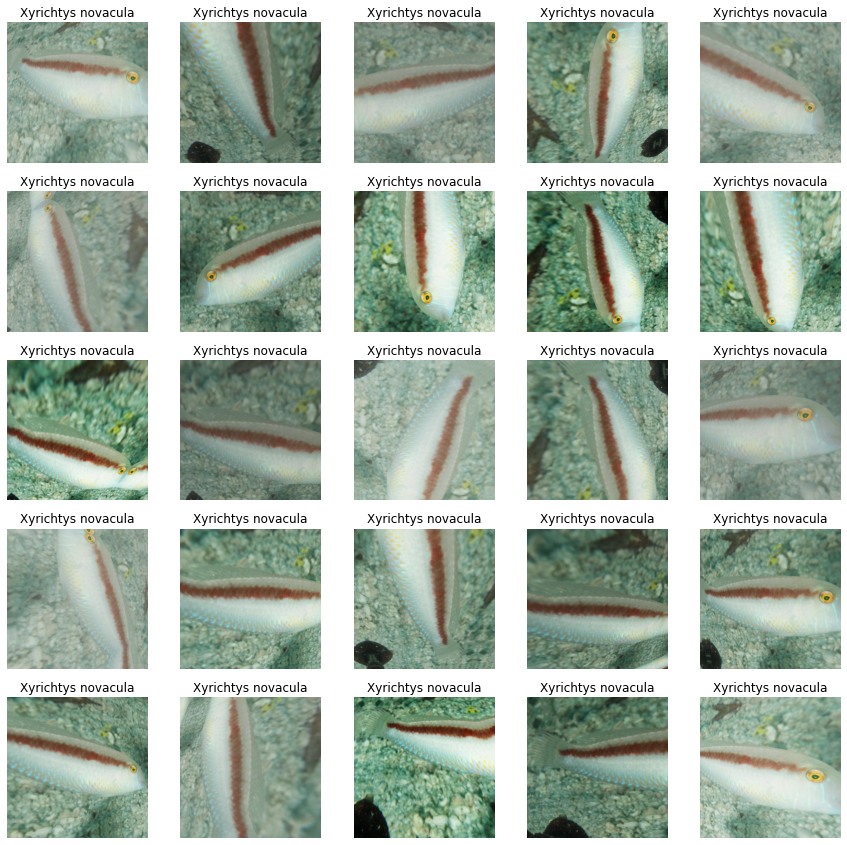

In [18]:
learner = create_reproducible_learner(
    resnet18,
    db_kwargs=dict(
        item_tfms=RandomResizedCrop(448, min_scale=0.5),
        batch_tfms=aug_transforms(mult=2.0, flip_vert=True),
    ),
    dls_kwargs=dict(verbose=True),
    learner_kwargs=dict(cbs=None),
)
learner.dls.show_batch(max_n=25)
learner.dls.show_batch(max_n=25, unique=True)

Found 539 items
2 datasets of sizes 432,107
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_species_from_path -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (448, 448), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.8, 'p': 1.0, 'draw': None, 'batch': False}


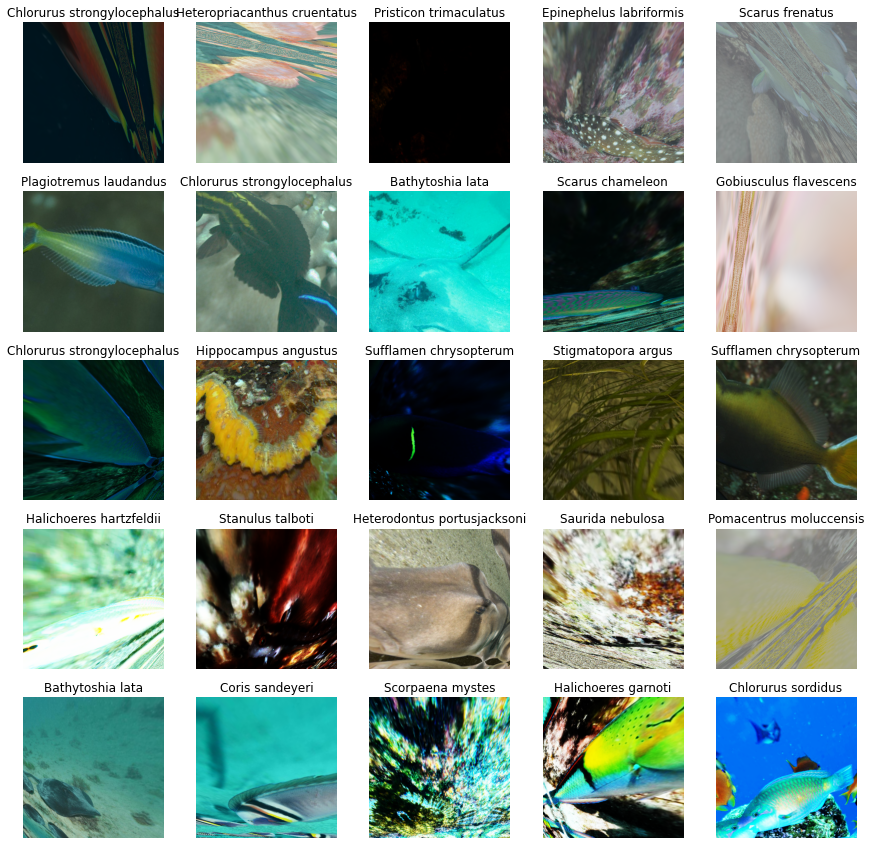

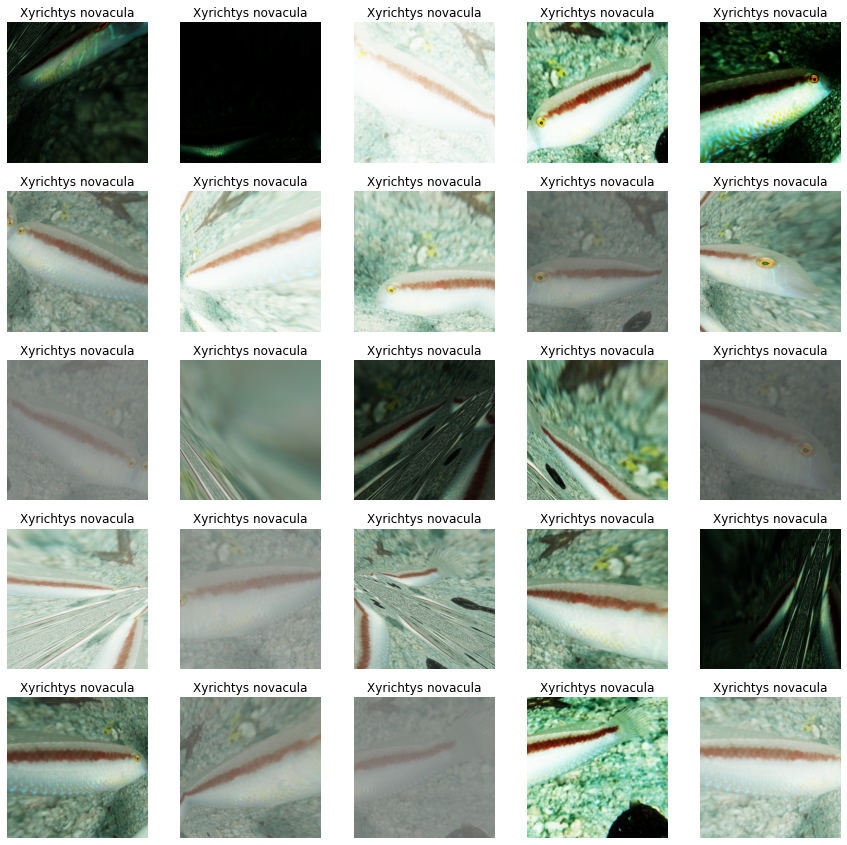

In [23]:
learner = create_reproducible_learner(
    resnet18,
    db_kwargs=dict(
        item_tfms=RandomResizedCrop(448, min_scale=0.5),
        batch_tfms=aug_transforms(mult=4.0, flip_vert=False),
    ),
    dls_kwargs=dict(verbose=True),
    learner_kwargs=dict(cbs=None),
)
learner.dls.show_batch(max_n=25)
learner.dls.show_batch(max_n=25, unique=True)

Found 539 items
2 datasets of sizes 432,107
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_species_from_path -> Categorize -- {'vocab': None, 'sort': True, 'add_na': False}
Setting up after_item: Pipeline: RandomResizedCrop -- {'size': (448, 448), 'min_scale': 0.5, 'ratio': (0.75, 1.3333333333333333), 'resamples': (2, 0), 'val_xtra': 0.14, 'max_scale': 1.0, 'p': 1.0} -> ToTensor
Setting up before_batch: Pipeline: 
Setting up after_batch: Pipeline: IntToFloatTensor -- {'div': 255.0, 'div_mask': 1} -> Flip -- {'size': None, 'mode': 'bilinear', 'pad_mode': 'reflection', 'mode_mask': 'nearest', 'align_corners': True, 'p': 0.5} -> Brightness -- {'max_lighting': 0.4, 'p': 1.0, 'draw': None, 'batch': False} -> RandomErasing -- {'p': 0.5, 'sl': 0.0, 'sh': 0.3, 'min_aspect': 0.3, 'max_count': 1}


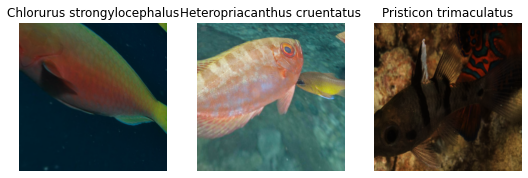

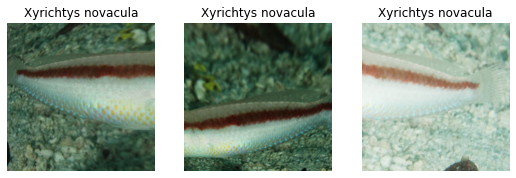

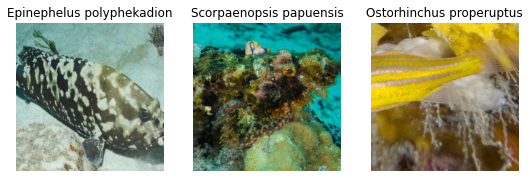

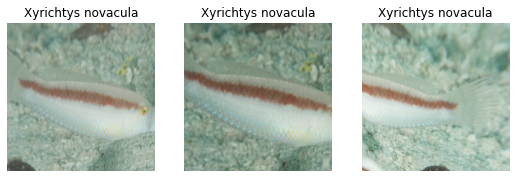

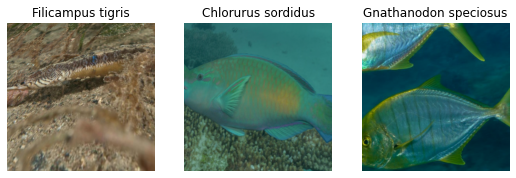

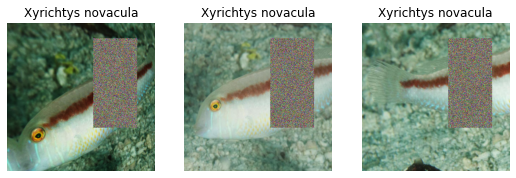

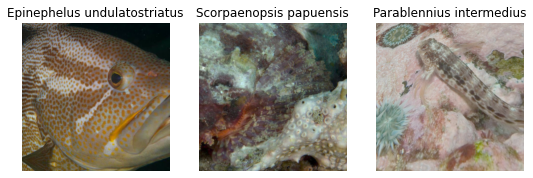

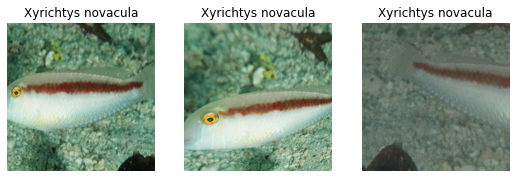

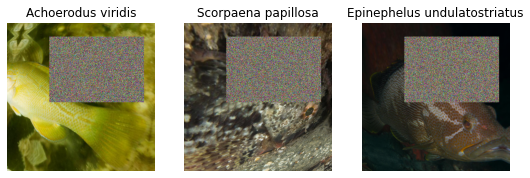

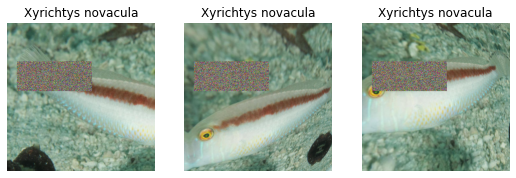

In [12]:
learner = create_reproducible_learner(
    resnet18,
    db_kwargs=dict(
        item_tfms=RandomResizedCrop(448, min_scale=0.5),
        batch_tfms=aug_transforms(mult=2.0, xtra_tfms=RandomErasing),
    ),
    dls_kwargs=dict(verbose=True),
    learner_kwargs=dict(cbs=None),
)
for _ in range(5):
    learner.dls.show_batch(max_n=3)
    learner.dls.show_batch(max_n=3, unique=True)

## Demo of data issues

Thoughts by category:

* `egg`/`tiny fry`: Probably worth manually filtering these out, as they're not useful as training or validation data.
* `duplicate of...`: md5 signatures are different, so it looks like these should be fixed at the source.
* `almost indistinct...`: Not much that can be done about well-camouflaged animals, but worth keeping in mind as a limitation.
* `large/mostly background`: May be addressed by adding fish detection to the pipeline. The prevalence of this issue explains why larger crops work better &ndash; they have a better chance of containing the subject.
* `multiple species`: Sometimes unavoidable, but may be addressed by fish detection and by larger crops &ndash; small random crops may be a different species.
* `school`: Not necessarily a bad thing, as crops have a good chance of containing multiple parts of the target species. Can be a problem with multiple species.
* `unusual angle`: Generally good to have multiple angles, but can be an impossible validation target if all the training samples are from the top and the validation is from the bottom (as in the ray example).

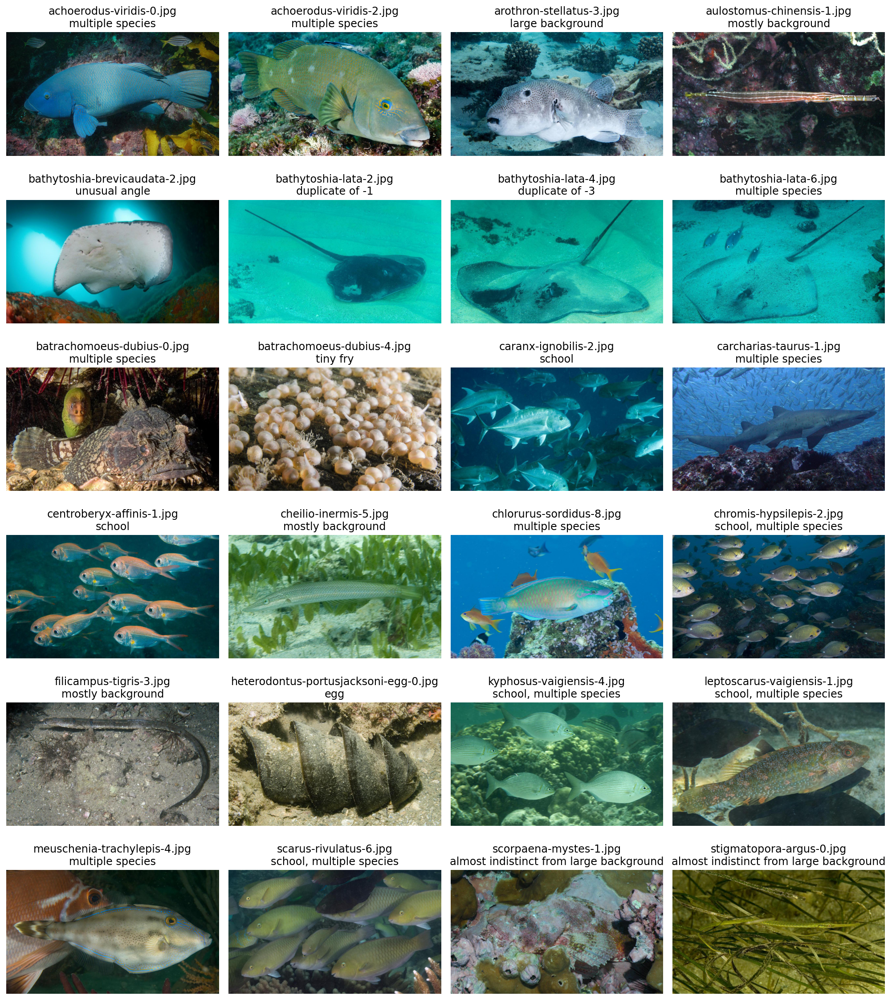

In [157]:
demo_images = {
    "achoerodus-viridis-0.jpg": "multiple species",
    "achoerodus-viridis-2.jpg": "multiple species",
    "arothron-stellatus-3.jpg": "large background",
    "aulostomus-chinensis-1.jpg": "mostly background",
    "bathytoshia-brevicaudata-2.jpg": "unusual angle",
    "bathytoshia-lata-2.jpg": "duplicate of -1",
    "bathytoshia-lata-4.jpg": "duplicate of -3",
    "bathytoshia-lata-6.jpg": "multiple species",
    "batrachomoeus-dubius-0.jpg": "multiple species",
    "batrachomoeus-dubius-4.jpg": "tiny fry",
    "caranx-ignobilis-2.jpg": "school",
    "carcharias-taurus-1.jpg": "multiple species",
    "centroberyx-affinis-1.jpg": "school",
    "cheilio-inermis-5.jpg": "mostly background",
    "chlorurus-sordidus-8.jpg": "multiple species",
    "chromis-hypsilepis-2.jpg": "school, multiple species",
    "filicampus-tigris-3.jpg": "mostly background",
    "heterodontus-portusjacksoni-egg-0.jpg": "egg",
    "kyphosus-vaigiensis-4.jpg": "school, multiple species",
    "leptoscarus-vaigiensis-1.jpg": "school, multiple species",
    "meuschenia-trachylepis-4.jpg": "multiple species",
    "scarus-rivulatus-6.jpg": "school, multiple species",
    "scorpaena-mystes-1.jpg": "almost indistinct from large background",
    "stigmatopora-argus-0.jpg": "almost indistinct from large background",
}
for (filename, desc), ax in zip(
    demo_images.items(), plt.subplots(6, 4, figsize=(14, 16))[1].flatten()
):
    show_image(
        PILImage.create(
            f"/home/yanir/projects/deep-fish/data/rls-species-100-min-images-4/{filename}"
        ),
        ctx=ax,
    )
    ax.set_title(f"{filename}\n{desc}")
plt.tight_layout()